# Playing Atari with Deep Reinforment Learning

The goal of the agent is to interact with the game by selecting actions s.t. maximises the (discounted) future rewards.

    E[R_0]= r_{0}+ γ*r_{1}+ γˆ2*r_{2} …… = E[∑t=0->n γ^t * r_{t+1}]

Defining the optimal policy as among all available actions at the current state, then choose the action that maximizes the expectated total R:

    Q*(s,a) = max(π) E[R_t |s_t=s, a_t=a, π]

if we assign the computation of successor states' reward R to some orcle V(s), now the expected value under optimal strategy following an important identity known as Bellman equation becomes:

    chooses a s.t. a = argmax(a') [E(r_t + γ*V(s_{t+1}))]

The basic idea behind reinformance learning algo is to estimate the action value function by using the Bellman equation above as iterative upate to Q_{i+1}(s,a). And such value iteration will eventually converge to the optimal action value function

Neural networks are universal function approximators, we can simply create one and train it to resemble Q.Combined with the Bellman equaition introduced above, this will give us the expected state action value to be the immediate reward plus the discounted accumulated value of the sucessor states as:

      Qπ (s,a) = r+ γ*Qπ (s′,π(s′))
  
      Q*(s,a) = E [r_t + γ*max(a')Q(s', a')|s, a]

In [34]:
import gym
from gym import envs
from gym import wrappers

import math
import random
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from collections import namedtuple
from itertools import count

import argparse
import logging
import sys

import torch
import torch.nn as nn
import torch.optim as optim
from torch.autograd import Variable

from network.DQN import DQN
from network.deepnet import Net




# set up matplotlib
is_ipython = 'inline' in matplotlib.get_backend()
if is_ipython:
    from IPython import display

plt.ion()


In [35]:
 
# if gpu is to be used
use_cuda = torch.cuda.is_available()
FloatTensor = torch.cuda.FloatTensor if use_cuda else torch.FloatTensor
LongTensor = torch.cuda.LongTensor if use_cuda else torch.LongTensor
ByteTensor = torch.cuda.ByteTensor if use_cuda else torch.ByteTensor
DoubleTensor = torch.cuda.DoubleTensor if use_cuda else torch.DoubleTensor
Tensor = FloatTensor


config = {
            "frame_size_h": 9,
            "frame_size_w": 9,
            "frame_size_d": 3,
            "action_list_n": 81,#83,
            "EPS_START": 0.8, #0.8, #1
            "EPS_END": 0.01, #0.1
            "EPS_DECAY": 100, #200,
            "BATCH_SIZE": 32,
            "GAMMA": 0.999,     
            "learning_rate": 1e-4,
            "replay_memory_capacity": 10000,
            "n_itr" : 100,
            "game_name": ""
            
        }

config_net = {
            "inputs_dim": 9*9*3,
            "hidden_dim": 100,
            "outputs_dim": 81 #83
}


# named tuple representing a single transition in enviornment
Transition = namedtuple('Transition',
                        ('state', 'action', 'reward', 'next_state'))
epoch_durations = []
average_total_Q = []
average_total_reward = []
average_loss = []
eps_decay = []




In [36]:

def plot_durations():
    fig = plt.figure(figsize=(14,14))
    plt.clf()
    ax1 = fig.add_subplot(2,2,1)
    ax2 = fig.add_subplot(2,2,2)
    ax3 = fig.add_subplot(2,2,3)
    ax4 = fig.add_subplot(2,2,4)

    reward_t = average_total_reward
    q_t = average_total_Q
    loss_ = average_loss
    eps_ = eps_decay
    
    ax1.plot([x/y for x, y in zip(reward_t, epoch_durations)])
    #ax1.plot(reward_t)
    ax2.plot(q_t)
    ax3.plot(loss_)
    ax4.plot(epoch_durations)
    # Take 100 episode averages and plot them too
    #if len(durations_t) >= 100:
    #    means = durations_t.unfold(0, 100, 1).mean(1).view(-1)
    #    means = torch.cat((torch.zeros(99), means))
     #   plt.plot(means.numpy())
        
    ax1.set_title('REWARD - Training '+ config["game_name"])
    ax2.set_title('Q VALUE - Training '+ config["game_name"])
    ax3.set_title('LOSS - Training ' + config["game_name"])
    ax4.set_title('Epoch Duration - Training ' + config["game_name"])
    ax1.set_xlabel('Epoch')
    ax2.set_xlabel('Epoch')
    ax3.set_xlabel('Epoch')
    ax1.set_ylabel('Average Reward per Epoch')
    ax2.set_ylabel('Average Action value(Q) oer Episode')
    ax3.set_ylabel('Average Loss per Episode')
    ax4.set_ylabel('Number of Steps before crash')

    plt.pause(0.001)  # pause a bit so that plots are updated
    if is_ipython:
        display.clear_output(wait=True)
        display.display(plt.gcf())


class ReplayMemory(object):

    def __init__(self, capacity):
        self.capacity = capacity
        self.memory =[]
        self.position = 0

    def save(self, *args):      # save a trasition
        if len(self.memory) < self.capacity:
            self.memory.append(None)
        self.memory[self.position]=Transition(*args)
        self.position= (self.position+1) % self.capacity


    def sample(self, batch_size):       # select random batch of transitions from memory
        return random.sample(self.memory, batch_size)


    def __len__(self):
        return len(self.memory)

    
def piecewise_scheduler(optimizer, epoch):
    if epoch % 20 ==0 :
        for param_group in optimizer.param_groups:
            lr =  param_group['lr'] / 2
            param_group['lr']  = lr

    return optimizer



In [37]:
def obFixer(observation_space,observation): 
    """
    Fixes observation ranges scale to [-1, 1], uses hyperbolic tangent for infinite values
        Args: 
            obsercation_space[nparray]
            observation
        Return:
            newObservation[nparray]
    """
    newObservation = []
    
    if observation_space.__class__ == gym.spaces.box.Box:
        for space in range(observation_space.shape[0]):
            high = observation_space.high[space]
            low = observation_space.low[space]
            if high == np.finfo(np.float32).max or high == float('Inf'):    #tanh to scale for inf
                newObservation.append(math.tanh(observation[space]))
                
            else:                         # current value percentage% to the range high-low
                dif = high - low 
                percent = (observation[space]+abs(low))/dif
                newObservation.append(((percent * 2)-1).tolist())
    
    return np.asarray(newObservation)





In [38]:


class QLearningAgent(object):
    """
    Agent implementing Deep Q-learning with experience replay
    """

    def __init__(self, observation_space, action_space, learnable=None, lr_scheduler= None, replay_memory_capacity=None):
        self.observation_space = observation_space
        self.action_space = action_space
        self.learnable = learnable
        self.epoch_done = 0

        #// initialize replay memory D to capacity N
        self.replay_memory = ReplayMemory(replay_memory_capacity if replay_memory_capacity is not None else config["replay_memory_capacity"])

        #// initialize Q network

        if self.learnable is not None:
            self.q = DQN(config["frame_size_h"], config["frame_size_w"], \
                         config["action_list_n"]) if self.learnable=='DQN' \
                    else \
                    Net(config_net["inputs_dim"], \
                        config["action_list_n"], config_net["hidden_dim"])
            
            self.q.float()    
            self.q.train(True)    
            self.loss =  torch.nn.MSELoss()  
            self.optimizer = optim.Adam(self.q.parameters(), lr=0.0001, betas=(0.001, 0.9), weight_decay=0.0001)
            #self.optimizer = optim.SGD(self.q.parameters(), lr=config["learning_rate"], momentum=0.9, weight_decay=0.0001)
            if lr_scheduler:
                    self.optimizer = lr_scheduler(self.optimizer, self.epoch_done + 1)
            self.tanh_clip = nn.Tanh()
            
            
        else:
            self.q = None
            
        
        
    def act_random(self):
        action = self.action_space.sample()
        #while action > config["action_list_n"]-1:
        #    action = self.action_space.sample()     # cap only for go game 
        return action, 0    


      
    def act_learn(self, observation, eps=None):
        """
        Epsilon greedy control off-policy strategy      
            Args: 
                observation[DoubleTensor]: 
            Return: 
                action[int64] : action picked
                value[float]: estimated Q value of corresponding action picked
        """
        
        if eps is None:
            eps= config["EPS_END"] + (config["EPS_START"]-config["EPS_END"]) * \
                math.exp(-1. *  self.epoch_done / config["EPS_DECAY"])
            eps_decay.append(eps)

        # Compute Q-values for each action,
        # pick the action that maximizes Q or random action 
        observation = observation.view(config_net["inputs_dim"]) if self.learnable=='DQN' \
                     else observation.view(1, config_net["inputs_dim"])
        qvalue_list = self.q(Variable(observation, volatile=True).type(FloatTensor)) 
        
        #qvalue_list = self.tanh_clip(qvalue_list).data   # 11/9
        
        if np.random.random() > eps:
            qvalue, action = torch.max(qvalue_list.data, 1)
            action = action.numpy()[0][0]   #from tensor 
            print "========= Q ACTION PICKING "
            print "Q(s) to pick from: "+str(qvalue_list)
            print "Agent pick the best one: " + str(action)
            print "of Q-value: "+ str(qvalue)
            print "========= \n"
        else: 
            qvalue, _= torch.max(qvalue_list.data, 1)
            action, _= self.act_random()
        
        qvalue = qvalue.numpy()[0][0]
        return action, qvalue     # always return MAX Q possible in current prediction 11/9

    def train(self, env):
        self.epoch_done=0
        t_num=0
        #reward_total=0.    # for 9x9 go
        for i in range(config["n_itr"]):
            print('')
            print(' =============================> Epoch ' + str(self.epoch_done))

            obs = env.reset()
            obs = obFixer(self.observation_space, obs)
            qvalue_total=0.
            loss_total=0.
            loss_data_=0.
            reward_total=0.     # for lunar land
            

            for t in count():
                print(' episode: ' + str(t+1))
                
                # Select and perform the action
                action, qvalue = self.act_random() if self.q is None \
                                    else self.act_learn(torch.from_numpy(obs))
                obs2, reward, done, info = env.step(action)
                obs2 = obFixer(self.observation_space, obs2)
                #print "OBS2: "+str(obs2)+"\n"
                #print (action, qvalue, reward, done)
                

                # Store transition into memory
                if done: 
                    obs2 = None
                #########################
                #_reward_ = 10.+reward #10. #5.+reward  
                #_reward_ = math.tanh(reward)
                #########################
                
                ## I'm guaranteeing half of good transitions  
                if (t_num%2==0 and reward >0) or (t_num%2!=0 and reward<0):
                    self.replay_memory.save(obs, action, reward, obs2)
                    t_num += 1
                    
                
                
                # Perform on step of optimization to Q net
                if self.q is not None:   # update model every 50 episode of interaction
                    loss_data_ = self.optimize_model()

                    
                reward_total += reward
                qvalue_total += qvalue
                loss_total += loss_data_
                obs = obs2 
                
                env.render()

                if done:
                    print 'Good Land!' if reward > 0 else 'Crash!'
                    average_total_reward.append(reward_total)
                    average_total_Q.append(qvalue_total/(t+1))
                    average_loss.append(loss_total/(t+1))
                    epoch_durations.append(t+1)
                    plot_durations()
                    break


            self.epoch_done += 1

        print('Complete')
        env.render(close=True)
        env.close()
        #plt.ioff()
        #plt.show()


    def optimize_model(self):

        BATCH_SIZE = config["BATCH_SIZE"]
        ACTION_LIST = config["action_list_n"]
        INPUT_SIZE = config_net["inputs_dim"]
        if len(self.replay_memory) < BATCH_SIZE:
            return 0.0

        transitions = self.replay_memory.sample(BATCH_SIZE)

        batch = Transition(*zip(*transitions))
        print ('sample batch from memory...\n')
        
              
        # Concatenate the batch elements of each
        # state, action , reward in every transition
        state_batch = Variable(torch.from_numpy(np.asarray(batch.state))).float()    ##.double()
        action_batch = Variable(torch.from_numpy(np.asarray(batch.action))).float() ##.double()
        reward_batch = Variable(torch.from_numpy(np.asarray(batch.reward))).float()  ##.double()

        self.optimizer.zero_grad()
        
        # Compute Q(s_t, a) by model
        # the model computes Q(s_t) and we select the columns
        # of actions taken in record
        state_values_ = self.q(\
                    state_batch if self.learnable=='DQN' else state_batch.view(-1,INPUT_SIZE)\
                    )
        ##############
        #print (" V(s_{t}, a): "+ str(state_values_))
        ##############
        ##############
        #print ("action batch: "+ str(action_batch))
        ##############
        
        ###################----- > section debugged 11/7  
        state_action_values = state_values_[0].view(1,ACTION_LIST).index_select(1, action_batch[0].long())
        for i in range(len(action_batch)-1):
            state_action_values = torch.cat((state_action_values, \
                                    state_values_[i+1].view(1,ACTION_LIST).index_select(1, action_batch[i+1].long())),0)
        state_action_values = state_action_values.index_select(1, Variable(torch.LongTensor([0])))
        #####################
        
        #state_action_values = self.tanh_clip(state_action_values)  #11/9
        
        ##############
        print (" Q(s_{t}, a): "+ str(state_action_values))
        ##############

        
        non_final_mask = ByteTensor(tuple(map(lambda s: s is not None,\
                                             batch.next_state)))
        # We don't want backprop expected action values, volatile shuts down requires-grad
        non_final_next_states = Variable (torch.cat([torch.from_numpy(x) for x in np.asarray(batch.state) \
                                           if x is not None]), volatile=True).float()        ##.double()
           
        # Compute state value V(s_{t+1}) by model for all next states,
        # then select the maxQ value of each:
        #
        ## MAX(a)Q(s_{t+1}, a)
        ###################---- waiting to be debugged
        next_state_values = Variable(torch.zeros(BATCH_SIZE).type(Tensor)).float()       ##.double()
        next_state_values[non_final_mask], _ = torch.max( self.q( \
            non_final_next_states if self.learnable=='DQN' \
                    else non_final_next_states.view(-1,INPUT_SIZE) \
            ), 1)   
        ###################
        
        #next_state_values = self.tanh_clip(next_state_values)   #11/9
        
        #############
        print("V(s_{t+1}): " + str(next_state_values))
        ############

        # Compute the expected Q values
        #
        ## Bellman equation
        ## Q_{t+1}(s,a) = r + gamma * MAX(a')Q(s', a')
        expected_state_action_values =  reward_batch + (next_state_values * config["GAMMA"]) 
        
        #############
        print("r: "+str(reward_batch))
        print("y_{t}: " + str(expected_state_action_values))
        ############
        

        # Compute Mean-Square Error loss from Q and expected Q*
        #
        ## loss(x, y) = 1/n sum|x-y|^2
        loss = self.loss(state_action_values, expected_state_action_values)
        #loss = F.smooth_l1_loss(state_action_values, expected_state_action_values)
        ##############
        #print("LOSS: " + str( loss.data.numpy()[0]))
        ################
        
        # Optimize model
        
        loss.backward()
        self.optimizer.step()
        
        return loss.data.numpy()[0]





The algorithm follows off-policy but epsilon controlled greedy strategy, where there is a probaility of epsilon value that action selected by the model (with the estimated max Q value) and select random action with proablity (1-epsilon).

During training, after each episode of interaction with the game enviornment (collect reward, and the next state by taking some action), we will push a transition T = { s{t}, reward, action, s{t+1} } to the replay memory D and we sample a batch of transitions from memory when we optimize our network and compute the following:

     the state action value estimated by model Q (s_t, a_t),
     the expected action state value y_i (also the target/label) estimated by model max(a')[Q(s',a')|s,a], with Bellman equation this giving us:
    
          y_i = Es'->end[ r + gamma * max(a')Q(s',a')|s, a ]
          
    note that in terminal state where V(s)=0, here Q(s_{t-1}, a) = rt
    
Loss is applied on the differece of predicted and expected by mean square error loss function in the preliminary experiments.

### Results On LunarLander-v2

In [39]:
config['game_name'] = 'LunarLander-v2'
config['action_list_n'] = 4
config_net['inputs_dim']  = 8
config_net['outputs_dim']  = 4
config_net['hidden_dim'] = 100

config ["n_itr"]  = 150
config ["BATCH_SIZE"] = 32


Reward for moving from the top of the screen to landing pad at coordinate [0,0] and zero speed is about 100..140 points.
Four actions:

    Do nothing
    Fire left orientation engine
    Fire main engine
    Fire right orientation engine
Episode finishes if the lander crashes or comes to rest, receiving additional -100 or +100 points. 
Each leg ground contact is +10. Firing main engine is -0.3 points each frame. 
Solved is 200 points.

####  THOUGHTS & NOTES 
    x 1. try tanh function clip r      
    √ 2. remove relu output, get normal range Q,V       
      3. try update the model at different rate
    √ 4. sample selection: guaranteen 50% good T/badd T, 
         
         ? * 必选 r=100   does r magnitude matter ??
         ? * 50/50 what's the best proportion p ??
         
      5. "we clipped all positive rewards at 1 and all negative rewards at −1, leaving 0 rewards unchanged... it could affect the performance of our agent since it cannot differentiate between rewards of different magnitude. 
    

#### RANDOM AGENT PLAY

In [ ]:
env = gym.make(config['game_name'])
random_agent = QLearningAgent(env.observation_space, env.action_space)
random_agent.train(env)

#### Q AGENT PLAY

In [ ]:
print "tanh clip r to +/-1\n remove last relu before output, get normal Q \n tanh replace relu. \n store 50% good transition"


env_ = gym.make('LunarLander-v2')
random_agent = QLearningAgent(env_.observation_space, env_.action_space, learnable="deepNet")
random_agent.train(env_)



 remove r clap 
 remove last relu before output, get normal est.Q value 
 tanh replace relu. 
 store 50% good transition


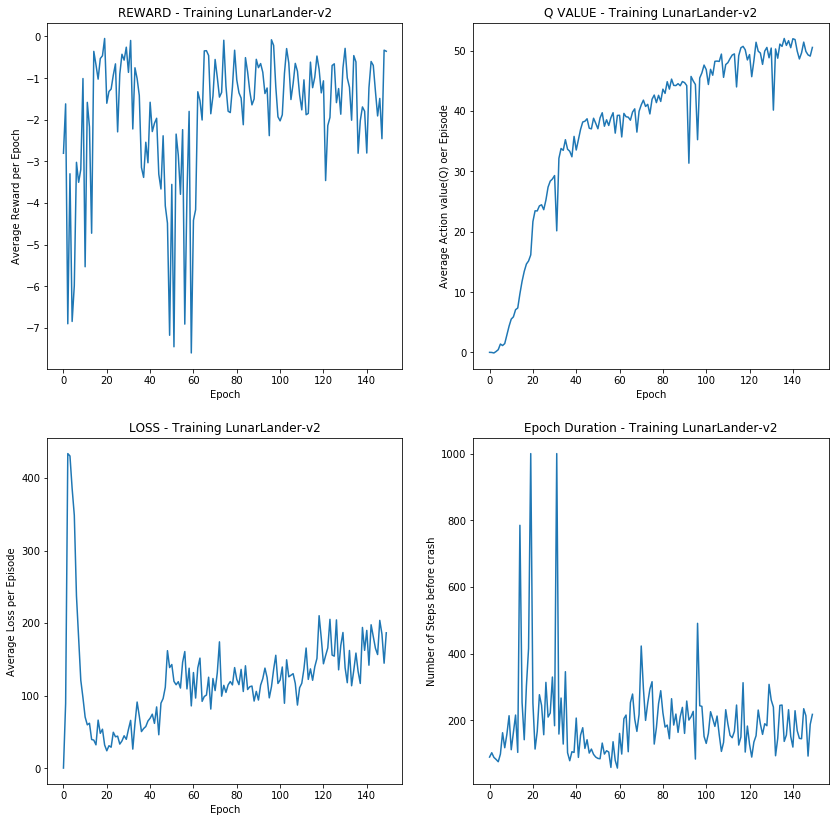

In [49]:
print "\n remove r clap \n remove last relu before output, get normal est.Q value \n tanh replace relu. \n store 50% good transition"
#env_ = gym.make('LunarLander-v2')
#random_agent = QLearningAgent(env_.observation_space, env_.action_space, learnable="deepNet")
#random_agent.train(env_)
#plot_durations()

try again as above.
 
 epsilon: 0.8 --> 0.01. step 100  (pre: 0.4-->0.01 step 200)


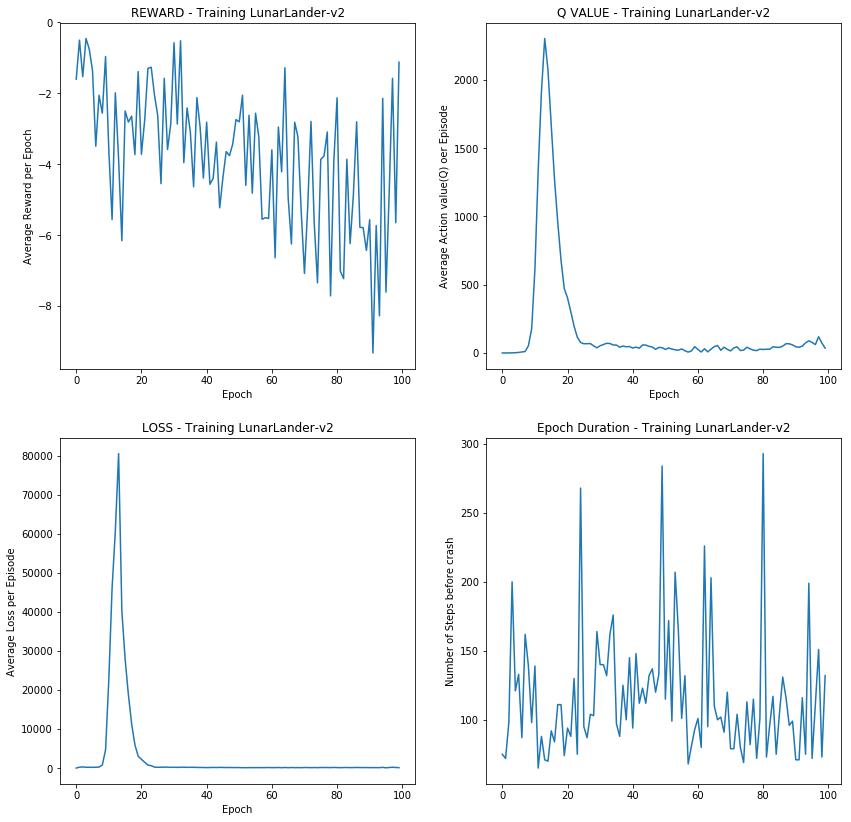

In [33]:
print 'try again as above.'
print ' \n epsilon: 0.8 --> 0.01. step 100  (pre: 0.4-->0.01 step 200)'
#env_ = gym.make('LunarLander-v2')
#random_agent = QLearningAgent(env_.observation_space, env_.action_space, learnable="deepNet")
#random_agent.train(env_)
plot_durations()


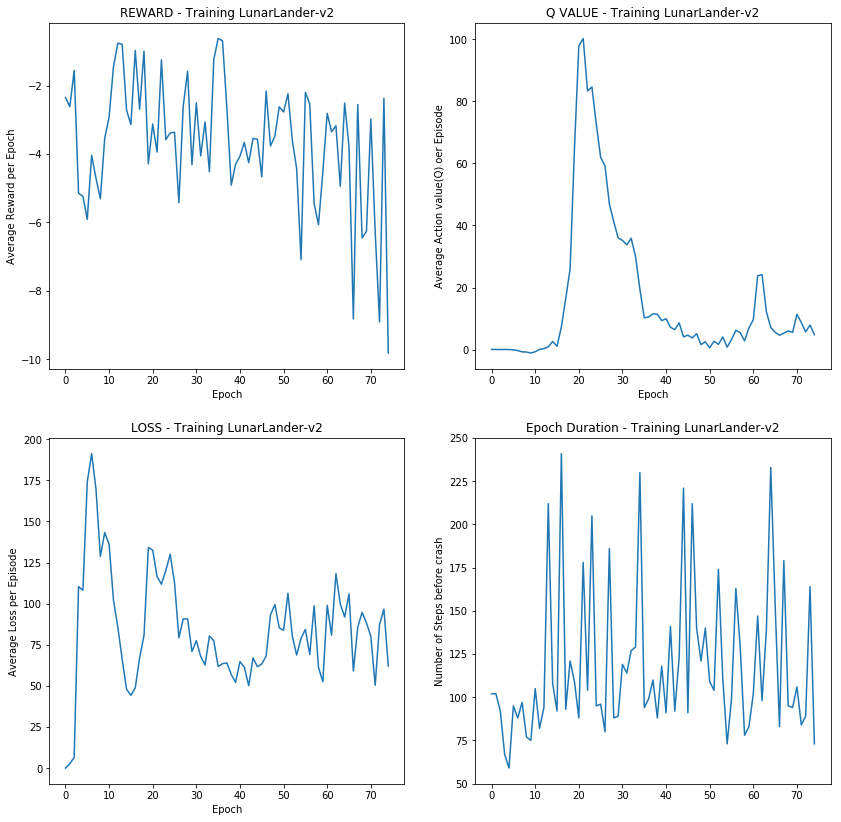


 =============================> Epoch 75
 episode: 1
sample batch from memory...

 Q(s_{t}, a): Variable containing:
 17.5943
  7.1573
-13.1421
 35.6091
  8.5405
  5.0433
  6.7631
-80.2617
 -6.9891
 -3.9608
 -2.3782
 -5.4631
 -0.4584
  3.8301
 -1.8253
 -4.7211
 -1.0112
 -7.9084
 -6.1010
 -4.1771
 -3.1011
  6.4387
 -3.7341
 -2.3430
  4.4082
 -2.1546
 -1.3540
 -2.5767
 -3.3157
 -1.8038
 14.3753
 -2.0914
[torch.FloatTensor of size 32x1]

V(s_{t+1}): Variable containing:
 17.5943
  7.1573
-11.2402
 43.5815
  8.5405
  5.0433
  8.1264
-69.6892
 -6.9014
 -3.2174
 -1.8411
 -5.4631
 -0.0934
  4.2972
 -1.1241
 -3.3529
 -0.8535
 -6.6578
 -4.4072
 -4.1771
 -3.0095
  7.7272
 -3.7341
 -1.8099
  5.5637
 -2.0406
 -0.7920
 -1.6382
 -2.3057
 -1.1437
 14.3753
 -2.0914
[torch.FloatTensor of size 32]

r: Variable containing:
 3.6273
 0.7048
 0.9964
 7.2289
-0.7862
 0.4450
-2.1375
-0.4085
 0.0071
 1.6490
-3.3234
-1.3870
 0.6480
-2.3973
 0.2152
-5.5715
-2.8472
 1.0717
-1.7949
 2.0926
 2.4720
-1.9488
 1.4546

 Q(s_{t}, a): Variable containing:
 15.7859
  2.1205
 -2.3430
 -0.0722
 -5.5718
 -1.6231
  6.7507
 13.4635
  3.7578
  5.9182
 17.6635
 -3.7549
  1.4192
 -5.6311
  0.8341
  0.0433
 -9.7827
 -2.0597
-10.2094
 -4.8884
  0.7725
 -4.2063
 -5.9704
  1.7538
 17.6564
 -3.7617
 13.4288
 -1.7106
  3.2683
 -1.3834
  1.8809
 -4.8022
[torch.FloatTensor of size 32x1]

V(s_{t+1}): Variable containing:
 15.7859
  2.1205
 -1.5491
  0.2156
 -3.9936
 -1.6231
  6.7507
 13.4635
  4.4018
  7.0311
 21.1138
 -2.6113
  1.6885
 -4.6930
  1.0312
  0.0433
 -7.2113
 -1.9543
 -7.5384
 -3.4729
  1.2159
 -3.4461
 -5.9704
  1.7538
 17.6564
 -3.0577
 13.4288
 -1.7106
  3.2683
 -0.8104
  1.8809
 -3.9676
[torch.FloatTensor of size 32]

r: Variable containing:
 1.5909
 0.2176
 0.2197
-0.7687
-6.4274
 0.2562
-0.5470
 1.9911
 0.1440
 0.1606
-2.6566
-2.5594
-1.5382
 1.0932
-0.7690
 0.6392
-3.7966
-0.0631
-4.0297
-3.2177
-0.7607
-0.3503
 1.9488
 3.0332
 3.6273
 0.3942
 2.3490
 1.0927
 0.2421
 0.9806
 2.3569
 0.1047
[torch.Flo

 Q(s_{t}, a): Variable containing:
 -1.6258
 -2.7658
 -6.6749
  4.6268
 21.3316
  9.4481
  0.5106
 14.2117
 -1.0329
  3.6646
 15.0536
 16.6140
  2.2116
 18.2461
  1.7553
  5.4835
 10.2874
 -9.3409
  2.9520
 -9.1519
 -7.1499
 -6.0687
 -0.5870
 -3.7850
 27.1216
 28.5149
 -0.1880
 -4.6871
  4.4825
  2.4645
 18.7819
 -8.0388
[torch.FloatTensor of size 32x1]

V(s_{t+1}): Variable containing:
 -1.6258
 -2.7658
 -4.8299
  4.6268
 26.3827
  9.4481
  0.5106
 14.2117
 -0.5337
  3.6646
 15.0536
 16.6140
  2.2116
 22.0337
  1.8824
  5.4835
 10.2874
 -6.8595
  2.9520
 -7.7277
 -7.0920
 -4.3650
 -0.4117
 -3.7850
 27.1216
 28.5149
  0.2025
 -3.3134
  4.4825
  3.2473
 23.3660
 -6.7513
[torch.FloatTensor of size 32]

r: Variable containing:
-2.2159
 2.1136
-1.1715
 3.5784
-1.7908
-0.8182
 0.2840
 0.7400
-1.2286
 0.9928
-0.4519
 1.5909
 3.2532
-2.8003
 0.4112
 0.7562
 0.2991
-6.8378
 0.0390
 0.8067
 0.9499
-4.6164
-2.9134
 0.5144
 3.4781
 0.1535
-1.4504
-2.7835
 1.2421
-1.3142
-1.0548
 0.8648
[torch.Flo

In [ ]:
print 'simple try again.'
env_ = gym.make('LunarLander-v2')
random_agent = QLearningAgent(env_.observation_space, env_.action_space, learnable="deepNet")
random_agent.train(env_)

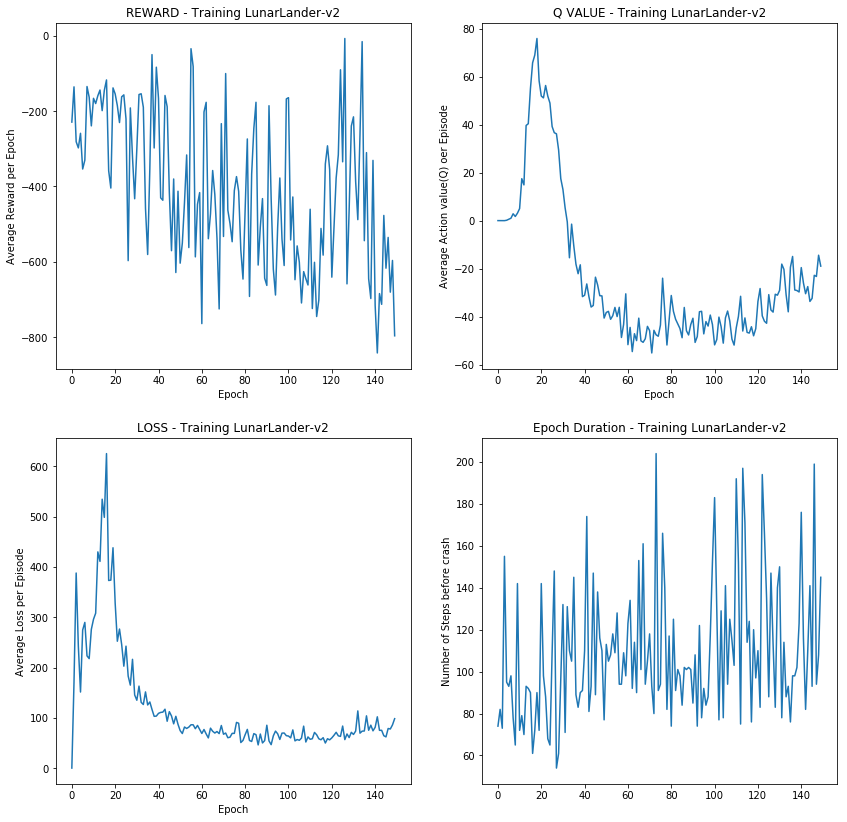

Complete


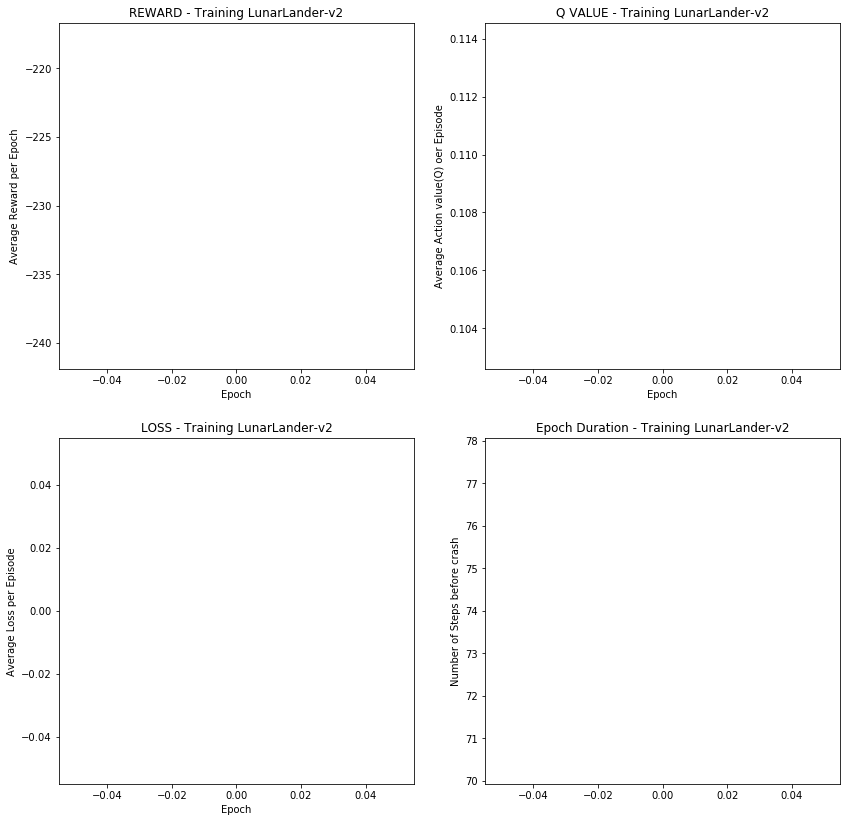

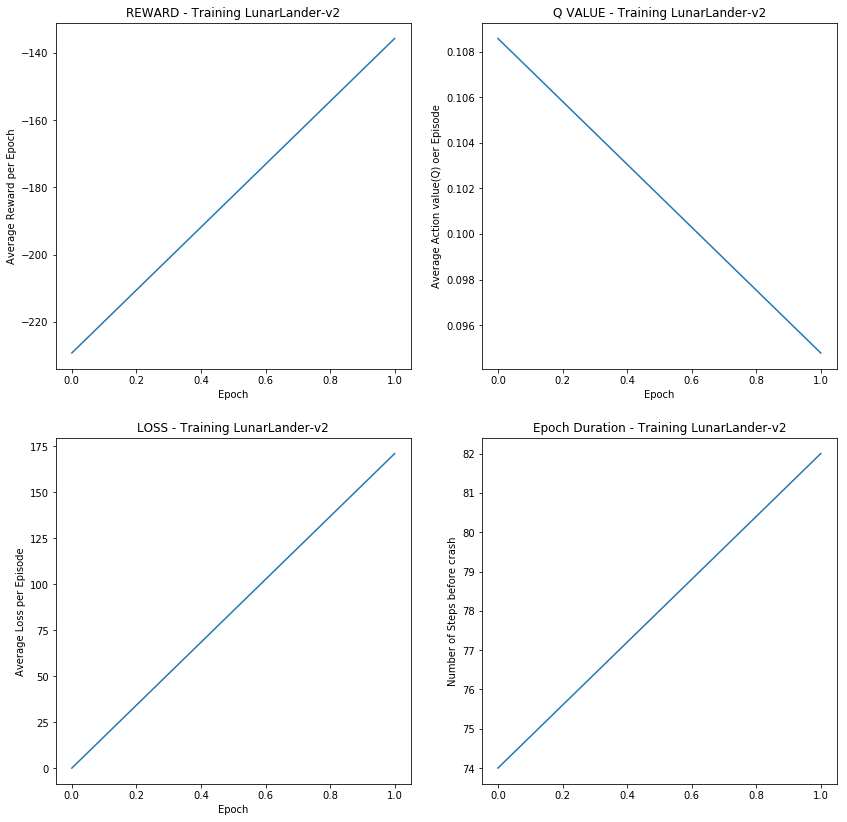

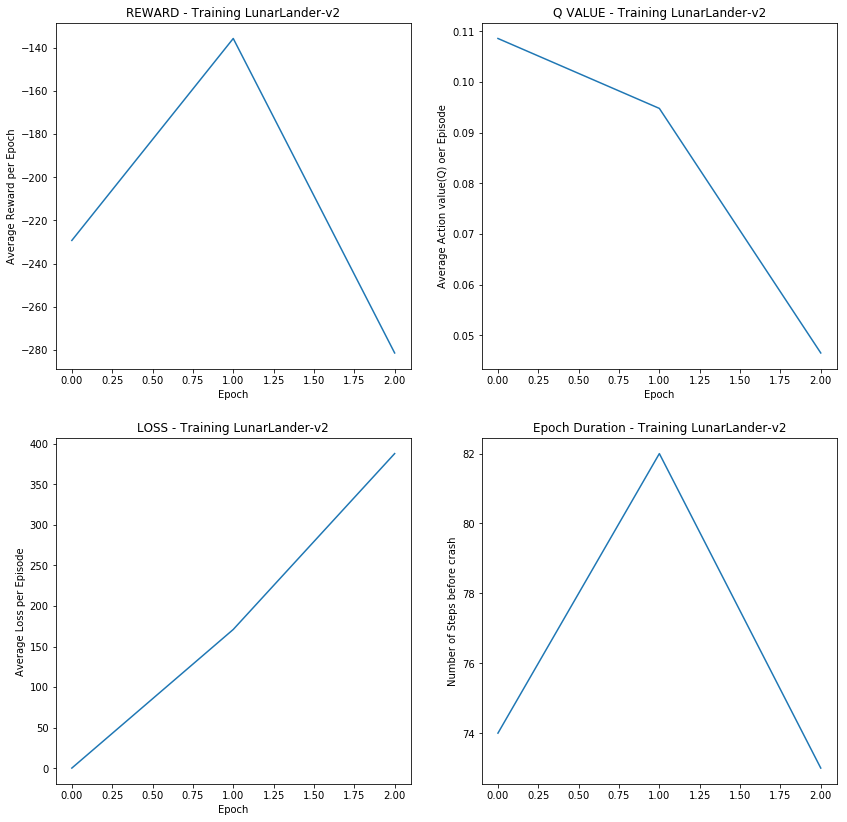

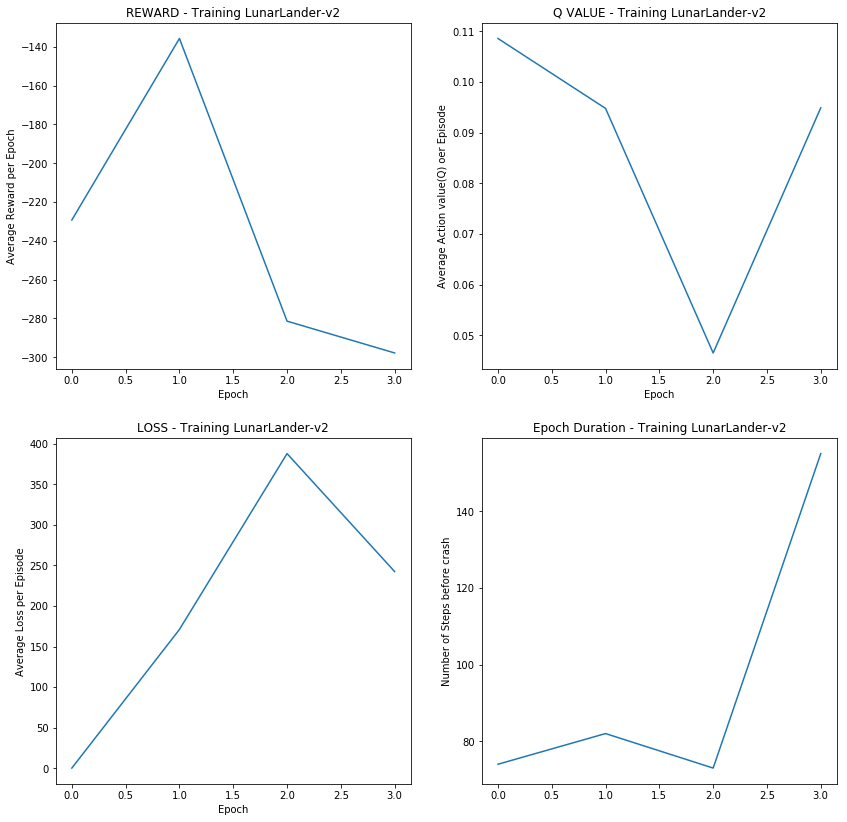

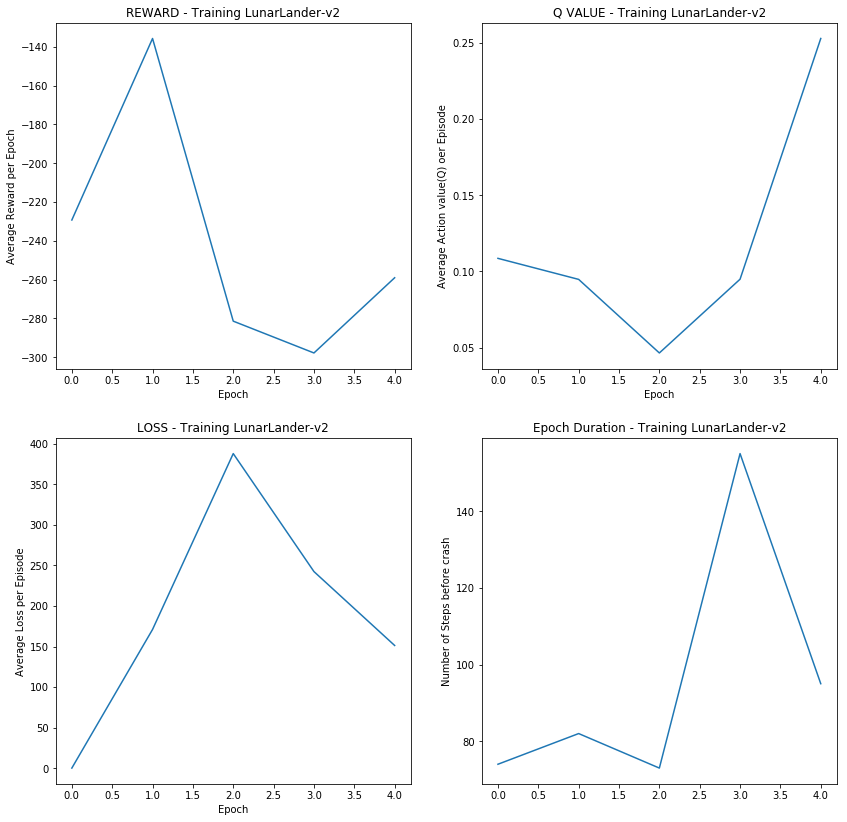

...

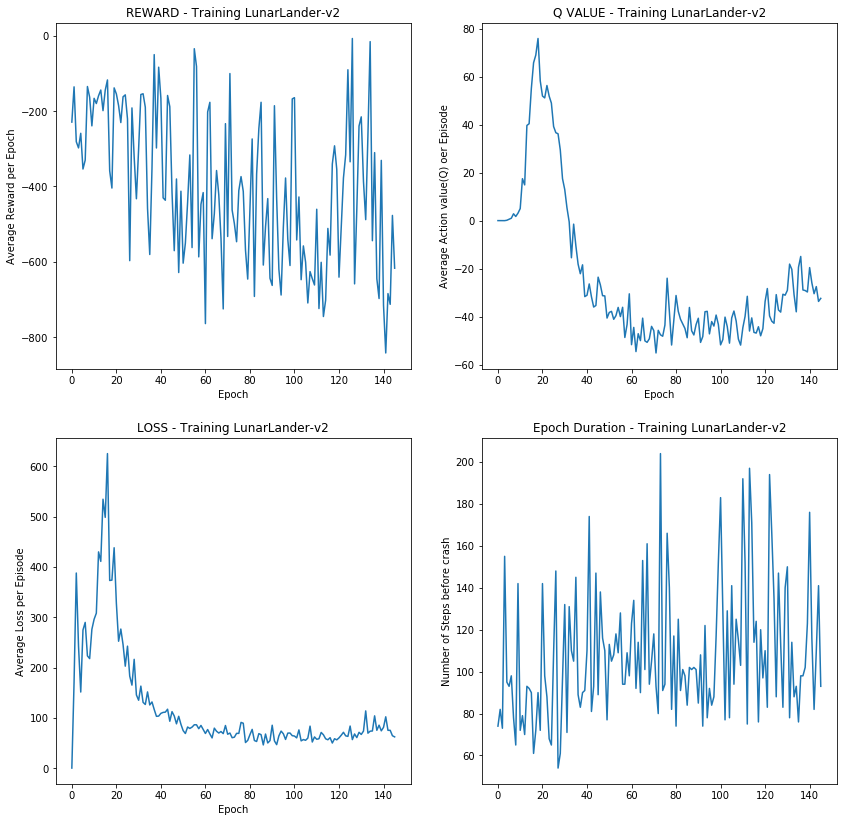

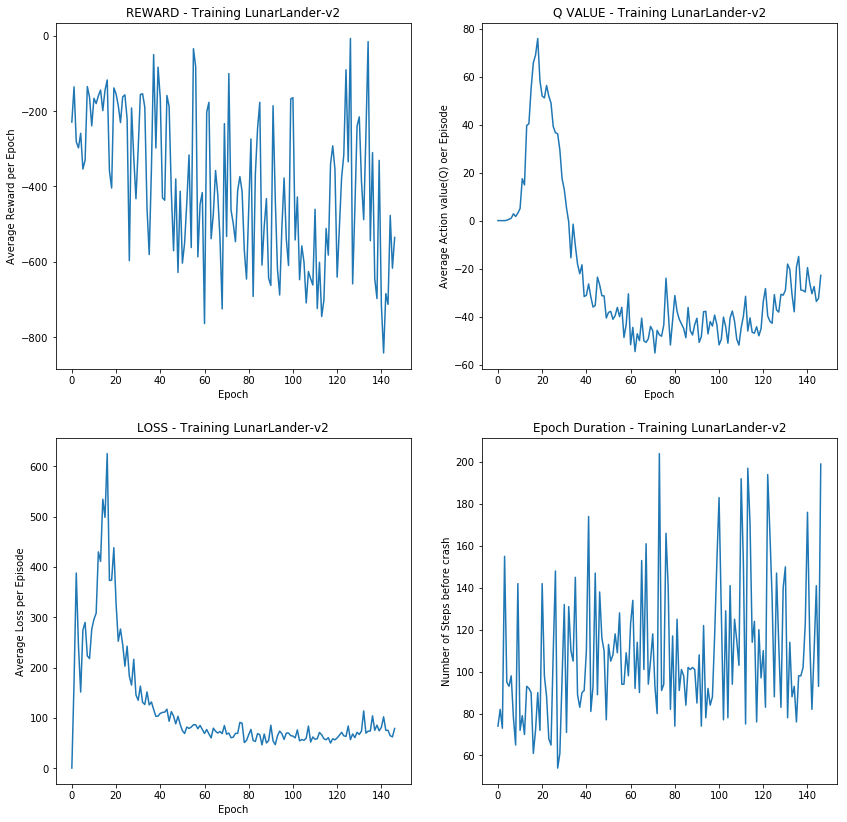

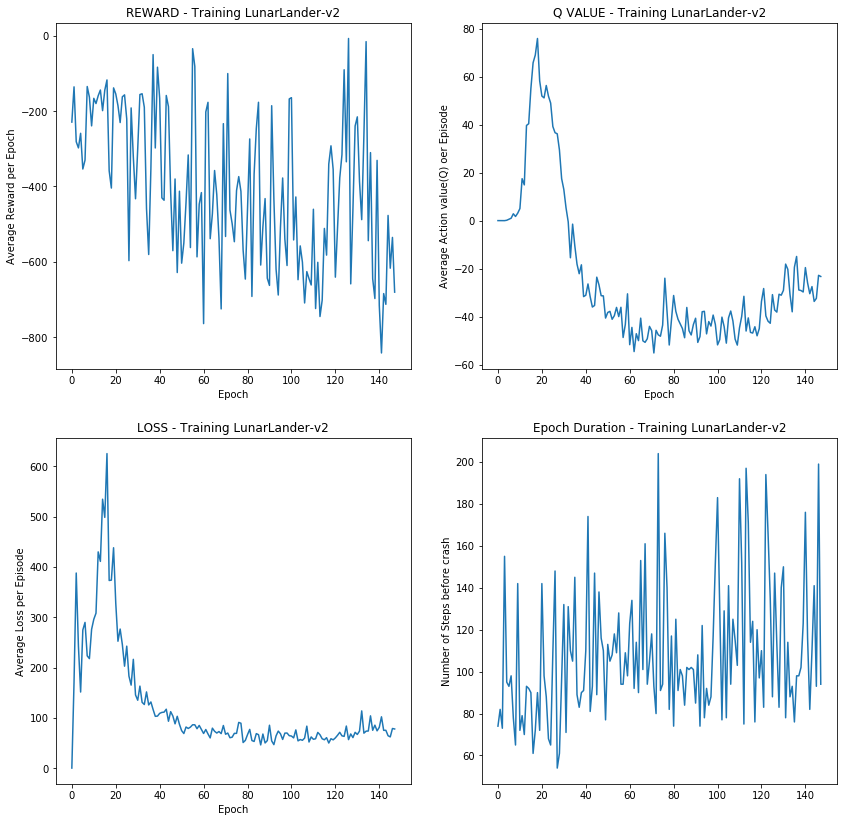

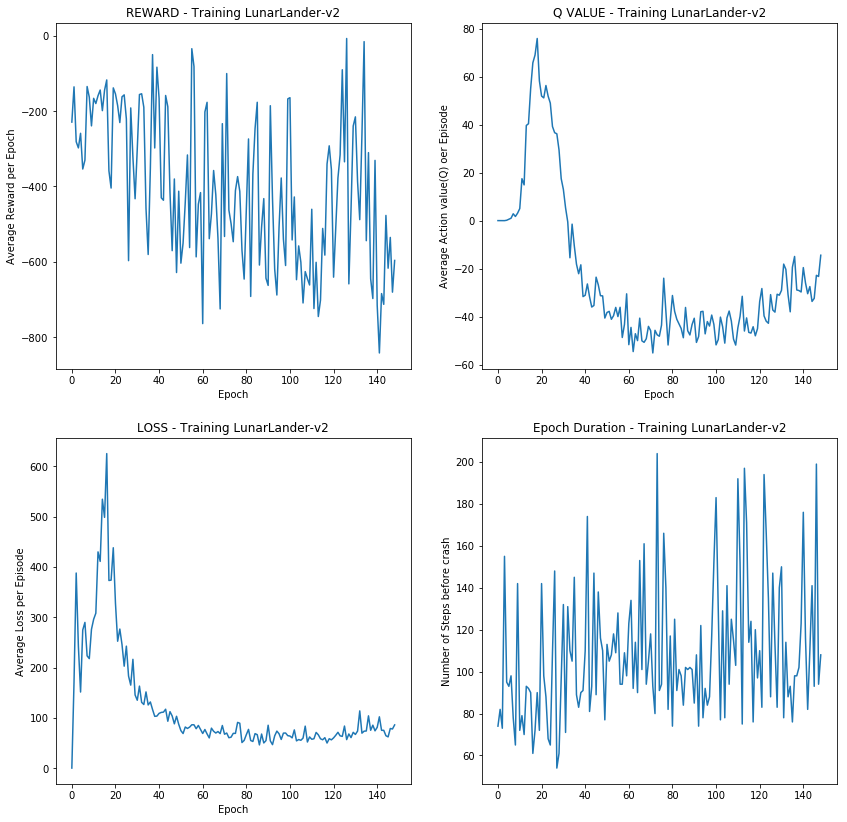

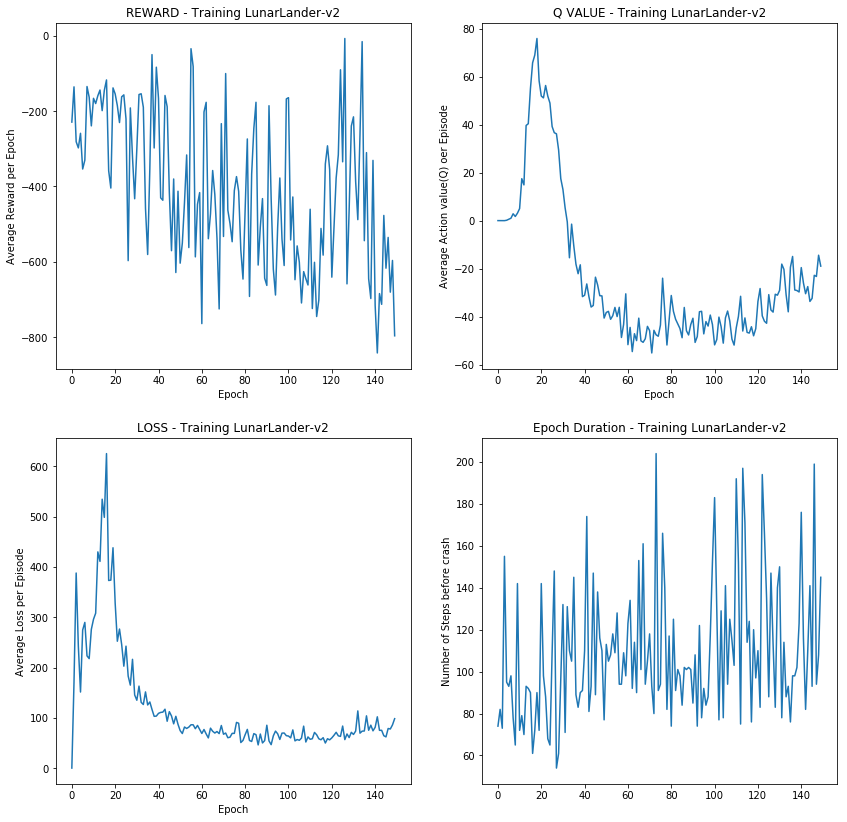

In [23]:
print '\n add BN.'
print ' epsilon: 0.8 --> 0.01. step 100  (pre: 0.4-->0.01 step 200)'
env_ = gym.make('LunarLander-v2')
random_agent = QLearningAgent(env_.observation_space, env_.action_space, learnable="deepNet")
random_agent.train(env_)







 rule to replace tanh in net. add BN after relu


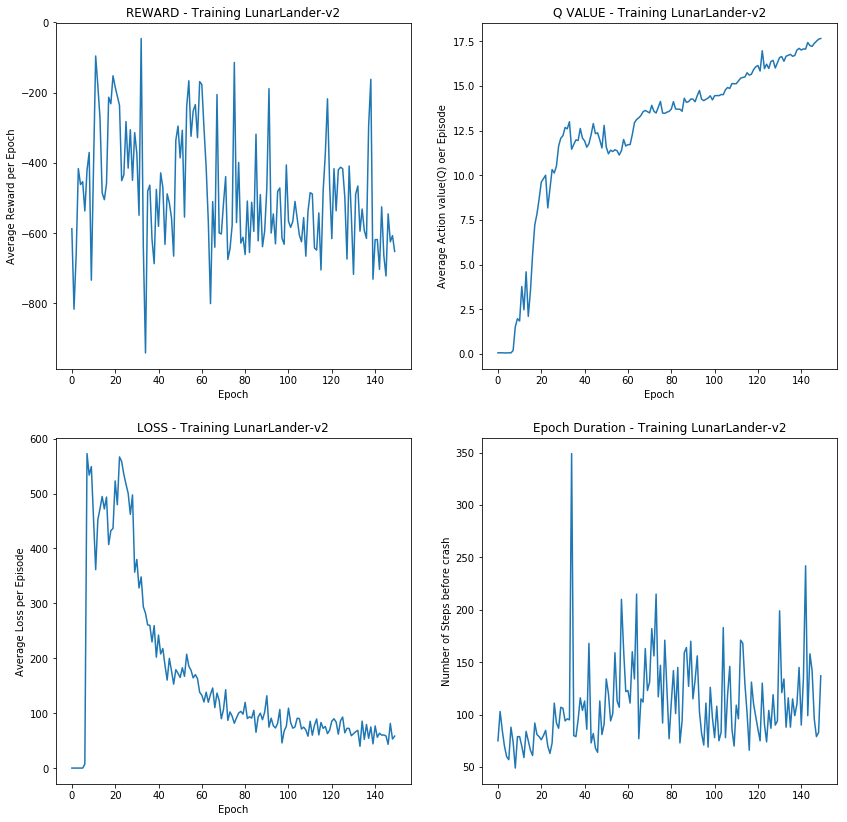

In [26]:
print "\n rule to replace tanh in net. add BN after relu"
#env_ = gym.make('LunarLander-v2')
#random_agent = QLearningAgent(env_.observation_space, env_.action_space, learnable="deepNet")
#random_agent.train(env_)
plot_durations()

In [ ]:
print 'remove BN.'
env_ = gym.make('LunarLander-v2')
random_agent = QLearningAgent(env_.observation_space, env_.action_space, learnable="deepNet")
random_agent.train(env_)
#plot_durations()